<a href="https://colab.research.google.com/github/jovitaand/Model-Reliability-Drift-Detection-in-Python/blob/main/Model_Reliability_Drift_Detection_in_Python.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Model Reliability: Drift Detection in Python

"Drift" in machine learning refers to the gradual decline in the performance of a model over time when it’s deployed in the real world. This happens because the environment where the model operates is dynamic - data changes, patterns evolve, and assumptions made during training may no longer hold true.

For example, a recommendation system trained on shopping trends from two years ago may struggle to predict what customers want today because consumer preferences and purchasing behaviors have changed. In essence, drift happens when the model's predictions stop aligning with the reality it’s trying to model.

## What is Drift?
When machine learning models are deployed, they are trained on historical data to predict outcomes or make decisions about the future. However, real-world data is rarely static - it evolves over time. Drift denotes the changes in the statistical properties of this data that lead to models losing their accuracy or behaving unpredictably.

For instance, a weather prediction model trained on seasonal data may underperform as climate patterns shift.

## Types of Drift
* Concept/Model Drift: The relationship between the input data (features) and the target variable changes. For example, a spam detection model trained on certain patterns might become ineffective as new spamming methods emerge. The model still 'sees' similar data but can't make accurate predictions because the "rules" have changed.
* Data Drift: (Also known as covariate shift) The distribution of the input data changes while the relationship between inputs and outputs remains the same.
Example: A sales prediction model trained on customer age and income data might deteriorate if the demographics of customers change (e.g., a younger audience starts shopping more frequently).

## How Do We Detect Drift?
Detecting drift is a critical part of maintaining reliable machine learning systems. This is where tools like Evidently come in handy. Evidently is an open-source drift detection library in Python which provides pre-built dashboards and metrics to monitor data drift. It automates the process of comparing the distributions of input features and outputs via statistical tests between two datasets:

* Reference Data: The baseline data, typically from model training.
* Current Data: New data collected during model use.


In [1]:
!pip install evidently
import evidently

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.3/105.3 kB 2.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.3/44.3 kB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.5/3.5 MB 20.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 231.1/231.1 kB 11.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 542.0/542.0 kB 13.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.6/53.6 kB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.7/63.7 kB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.1/79.1 kB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 442.1/442.1 kB 8.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 210.3/210.3 kB 9.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.1/59.1 kB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.8/3.8 MB 22.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 425.7/

In [2]:
import pandas as pd
import numpy as np


import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, roc_auc_score
from sklearn.pipeline import Pipeline
from sklearn.utils import Bunch
from sklearn.metrics import (
    balanced_accuracy_score,
    roc_auc_score,
    accuracy_score,
    recall_score,
    confusion_matrix,
    roc_auc_score,
    roc_curve,
    RocCurveDisplay)

# Set display options
pd.set_option("display.float_format", "{:.2f}".format)
sns.set()

from evidently import ColumnMapping

from evidently.report import Report
from evidently.metrics.base_metric import generate_column_metrics
from evidently.metric_preset import DataDriftPreset, TargetDriftPreset, DataQualityPreset, RegressionPreset
from evidently.metrics import *

from evidently.test_suite import TestSuite
from evidently.tests.base_test import generate_column_tests
from evidently.test_preset import DataStabilityTestPreset, NoTargetPerformanceTestPreset, RegressionTestPreset
from evidently.tests import *

## Load the dataset


Let's load the dataset and review it like we did last time.


In [3]:
df = pd.read_csv("https://respai.s3.us-east-2.amazonaws.com/fairlern_data_preprocessed.csv")

In [4]:
df.head()

,race,gender,age,discharge_disposition_id,admission_source_id,time_in_hospital,medical_specialty,num_lab_procedures,num_procedures,num_medications,...,change,diabetesMed,medicare,medicaid,had_emergency,had_inpatient_days,had_outpatient_days,readmitted,readmit_binary,readmit_30_days
0,Caucasian,Female,30 years or younger,Other,Referral,1,Other,41,0,1,...,No,No,False,False,False,False,False,NO,0,0
1,Caucasian,Female,30 years or younger,Discharged to Home,Emergency,3,Missing,59,0,18,...,Ch,Yes,False,False,False,False,False,>30,1,0
2,AfricanAmerican,Female,30 years or younger,Discharged to Home,Emergency,2,Missing,11,5,13,...,No,Yes,False,False,False,True,True,NO,0,0
3,Caucasian,Male,30-60 years,Discharged to Home,Emergency,2,Missing,44,1,16,...,Ch,Yes,False,False,False,False,False,NO,0,0
4,Caucasian,Male,30-60 years,Discharged to Home,Emergency,1,Missing,51,0,8,...,Ch,Yes,False,False,False,False,False,NO,0,0


In [5]:
# Show the values of all binary and categorical features
categorical_values = {}
for col in df:
  if col not in {'time_in_hospital', 'num_lab_procedures',
                 'num_procedures', 'num_medications', 'number_diagnoses'}:
    categorical_values[col] = pd.Series(df[col].value_counts().index.values)
categorical_values_df = pd.DataFrame(categorical_values).fillna('')
categorical_values_df.T

,0,1,2,3,4,5
race,Caucasian,AfricanAmerican,Unknown,Hispanic,Other,Asian
gender,Female,Male,Unknown/Invalid,,,
age,Over 60 years,30-60 years,30 years or younger,,,
discharge_disposition_id,Discharged to Home,Other,,,,
admission_source_id,Emergency,Referral,Other,,,
medical_specialty,Missing,Other,InternalMedicine,Emergency/Trauma,Family/GeneralPractice,Cardiology
primary_diagnosis,Other,Respiratory Issues,Diabetes,Genitourinary Issues,Musculoskeletal Issues,
max_glu_serum,Norm,>200,>300,,,
A1Cresult,>8,Norm,>7,,,
insulin,No,Steady,Down,Up,,


Save a list of all categorical features:

In [6]:
categorical_features = [
    "race",
    "gender",
    "age",
    "discharge_disposition_id",
    "admission_source_id",
    "medical_specialty",
    "primary_diagnosis",
    "max_glu_serum",
    "A1Cresult",
    "insulin",
    "change",
    "diabetesMed",
    "readmitted"
]

In [7]:
for col_name in categorical_features:
  df[col_name] = df[col_name].astype("category")

## Data Preprocessing

Normalized sensitive attribute frequencies from last time:

In [8]:
df["race"].value_counts(normalize=True)

,proportion
race,
Caucasian,0.75
AfricanAmerican,0.19
Unknown,0.02
Hispanic,0.02
Other,0.01
Asian,0.01


In our dataset, our patients are predominantly *Caucasian* (75%). The next largest racial group is *AfricanAmerican*, making up 19% of the patients. The remaining race categories (including *Unknown*) compose only 6% of the data.

In [9]:
# retain the original race as race_all, and merge Asian+Hispanic+Other
df["race_all"] = df["race"]
df["race"] = df["race"].replace({"Asian": "Other", "Hispanic": "Other"})

# drop gender group Unknown/Invalid
df = df.query("gender != 'Unknown/Invalid'")

<ipython-input-9-6ab4e55bd3f4>:3: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  df["race"] = df["race"].replace({"Asian": "Other", "Hispanic": "Other"})


This dataset has been used by [Strack et al. (2014)](https://www.hindawi.com/journals/bmri/2014/781670/) to model the relationship between patient readmission and HbA1c measurement during admission, based on primary medical diagnosis.

The dataset is publicly available through the UCI Machine Learning Repository and, as of May 2021, has received over 350,000 views.

# Training the initial models

## Prepare training and test datasets

As we mentioned in the task definition, our target variable is **readmission within 30 days**, and our sensitive feature is **race**.


In [10]:
target_variable = "readmit_30_days"
demographic = ["race", "gender"]
sensitive = ["race"]

In [11]:
Y = df.loc[:, target_variable]

We next drop the features that we don't want to use in our model and expand the categorical features into 0/1 indicators ("dummies").

In [12]:
X = pd.get_dummies(df.drop(columns=[
    "race",
    "race_all",
    "discharge_disposition_id",
    "readmitted",
    "readmit_binary",
    "readmit_30_days"
]))

In [13]:
X.head() # sanity check

,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_diagnoses,medicare,medicaid,had_emergency,had_inpatient_days,had_outpatient_days,...,A1Cresult_>8,A1Cresult_Norm,insulin_Down,insulin_No,insulin_Steady,insulin_Up,change_Ch,change_No,diabetesMed_No,diabetesMed_Yes
0,1,41,0,1,1,False,False,False,False,False,...,False,False,False,True,False,False,False,True,True,False
1,3,59,0,18,9,False,False,False,False,False,...,False,False,False,False,False,True,True,False,False,True
2,2,11,5,13,6,False,False,False,True,True,...,False,False,False,True,False,False,False,True,False,True
3,2,44,1,16,7,False,False,False,False,False,...,False,False,False,False,False,True,True,False,False,True
4,1,51,0,8,5,False,False,False,False,False,...,False,False,False,False,True,False,True,False,False,True


In [14]:
random_seed = 123
np.random.seed(random_seed)

In [15]:
X_train, X_test, Y_train, Y_test, df_train, df_test = train_test_split(
    X,
    Y,
    df,
    test_size=0.20,
    stratify=Y,
    random_state=random_seed
)

Our performance metric is **balanced accuracy**, so for the purposes of training (but not evaluation!) we will resample the data set, so that it has the same number of positive and negative examples.


Because we are downsampling the number of negative examples, we create a training dataset with a significantly lower number of data points. For more complex machine learning models, this lower number of training data points may affect the model's accuracy.

In [16]:
def resample_dataset(X_train, Y_train):

  negative_ids = Y_train[Y_train == 0].index
  positive_ids = Y_train[Y_train == 1].index
  balanced_ids = positive_ids.union(np.random.choice(a=negative_ids, size=len(positive_ids)))

  X_train = X_train.loc[balanced_ids, :]
  Y_train = Y_train.loc[balanced_ids]
  return X_train, Y_train

In [17]:
X_train_bal, Y_train_bal = resample_dataset(X_train, Y_train)

## Save descriptive statistics of training and test data

We next evaluate the descriptive statistics of the training dataset. These can be provided as part of _model cards_ to document our training.

Text(0.5, 1.0, 'Target Label Histogram for Training Dataset')

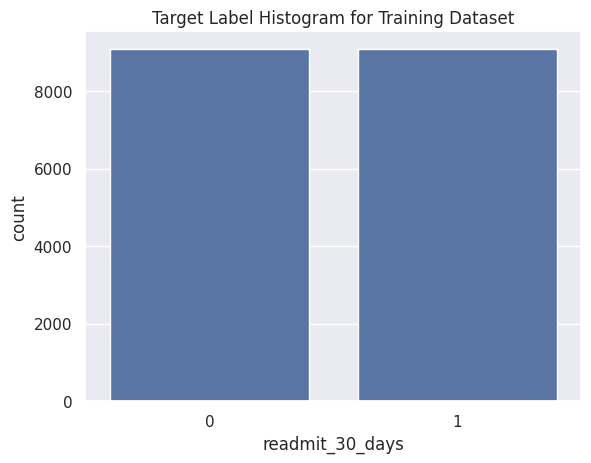

In [18]:
sns.countplot(x=Y_train_bal)
plt.title("Target Label Histogram for Training Dataset")

Text(0.5, 1.0, 'Target Label Histogram for Test Dataset')

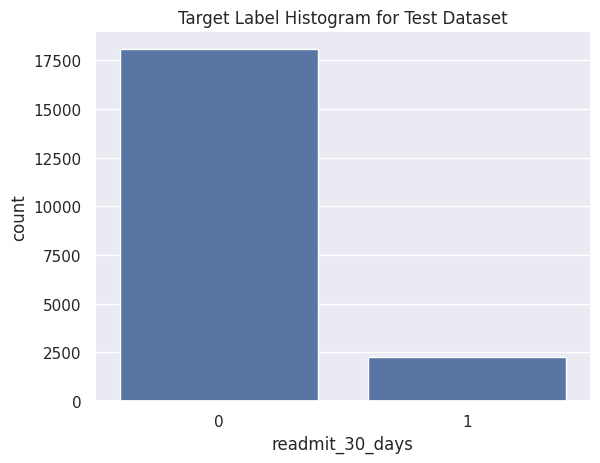

In [19]:
sns.countplot(x=Y_test)
plt.title("Target Label Histogram for Test Dataset")

## Train the logistic regression model

We train a logistic regression model and save its predictions on test data for analysis.

In [20]:
pipeline = Pipeline(steps=[
    ("preprocessing", StandardScaler()),
    ("logistic_regression", LogisticRegression(max_iter=1000))
])

In [21]:
pipeline.fit(X_train_bal, Y_train_bal)

Pipeline(steps=[('preprocessing', StandardScaler()),
                ('logistic_regression', LogisticRegression(max_iter=1000))])

In [22]:
Y_pred_proba = pipeline.predict_proba(X_test)[:,1]
Y_pred = pipeline.predict(X_test)

In [23]:
Y_pred

array([0, 0, 0, ..., 1, 1, 0])

Check model performance on test data.

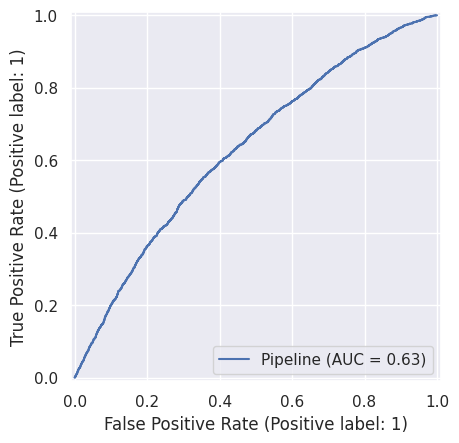

In [24]:
# Plot ROC curve of probabilistic predictions
RocCurveDisplay.from_estimator(pipeline, X_test, Y_test);

In [25]:
# Show balanced accuracy rate of the 0/1 predictions
balanced_accuracy_score(Y_test, Y_pred)

0.5975743677793287

In [26]:
Y_test[:10]

,readmit_30_days
21874,0
29877,0
706,0
63792,0
85957,0
15077,0
83540,0
32166,0
39933,0
56361,0


In [27]:
Y_pred[:10]

array([0, 0, 0, 0, 1, 1, 1, 0, 0, 0])

In [28]:
df.columns

Index(['race', 'gender', 'age', 'discharge_disposition_id',
       'admission_source_id', 'time_in_hospital', 'medical_specialty',
       'num_lab_procedures', 'num_procedures', 'num_medications',
       'primary_diagnosis', 'number_diagnoses', 'max_glu_serum', 'A1Cresult',
       'insulin', 'change', 'diabetesMed', 'medicare', 'medicaid',
       'had_emergency', 'had_inpatient_days', 'had_outpatient_days',
       'readmitted', 'readmit_binary', 'readmit_30_days', 'race_all'],
      dtype='object')

# Example Workflow with Evidently

### Specify Reference & Current Data to Evidently

In [29]:
X_train_bal['prediction'] = pipeline.predict(X_train_bal)
X_test['prediction'] = Y_pred
reference = X_train_bal
current = X_test


## Report

In [30]:
report = Report(metrics=[
    DataDriftPreset(),
])

report.run(reference_data=reference, current_data=current)
report

Evidently uses different statistical tests depending on data type and dataset size:
* For numerical features, it measures the overall spread and shift (KS test for small data, Wasserstein for large).
* For categorical features, it counts and compares proportions (Chi-squared for small data, Jensen-Shannon for large).

You can read more about Evidently's Drift Detection algorithm here: https://docs.evidentlyai.com/reference/data-drift-algorithm

## Test Suite

In [31]:
tests = TestSuite(tests=[
    TestNumberOfColumnsWithMissingValues(),
    TestNumberOfRowsWithMissingValues(),
    TestNumberOfConstantColumns(),
    TestNumberOfDuplicatedRows(),
    TestNumberOfDuplicatedColumns(),
    TestColumnsType(),
    TestNumberOfDriftedColumns(),
])

tests.run(reference_data=reference, current_data=current)
tests

# DATA DRIFT EXAMPLE WITH 'PRODUCTION' DATA
To show how Evidently's diagnostic tools work, we'll create synthetic production data by copying the test set and making small changes to introduce drift in one numerical and one categorical variable. We'll use this modified dataset as our "current data."

In [32]:
synthetic_data = X_test.copy()

original_mean = synthetic_data["num_lab_procedures"].mean()
synthetic_data["num_lab_procedures"] += np.random.normal(loc=5, scale=2, size=synthetic_data.shape[0])


synthetic_data["gender_Female"] = np.random.choice(
    [True, False],
    size=synthetic_data.shape[0],
    p=[0.2, 0.8]
)


current = synthetic_data


In [33]:
original_mean = X_test["num_lab_procedures"].mean()
original_mean

43.36151918636073

In [34]:
new_mean = synthetic_data["num_lab_procedures"].mean()
new_mean

48.36772549751348

In [35]:
X_test["gender_Female"].value_counts()

,count
gender_Female,
True,11050
False,9303


In [36]:
synthetic_data["gender_Female"].value_counts()

,count
gender_Female,
False,16267
True,4086


In [37]:
report = Report(metrics=[
    DataDriftPreset(),
])

report.run(reference_data=reference, current_data=current)
report

Disaggregating numerical data plots:

In [38]:
report = Report(metrics=[
    DataDriftPreset(),
], options={"render": {"raw_data": True}})

report.run(reference_data=reference, current_data=current)
report

## YOUR TASK:

Modify the code above to introduce drift in another set of a categorical and numerical variable, generate a new Report, and comment (in 2-3 sentences) on the results:

In [39]:
synthetic_data = X_test.copy()

#Num variable of your choice
original_mean = synthetic_data["number_diagnoses"].mean()
synthetic_data["number_diagnoses"] += np.random.normal(loc=5, scale=2, size=synthetic_data.shape[0])

#Cat variable of your choice
synthetic_data["had_outpatient_days"] = np.random.choice(
    [True, False],
    size=synthetic_data.shape[0],
    p=[0.8, 0.2]
)


current = synthetic_data

In [40]:
report = Report(metrics=[
    DataDriftPreset(),
])

report.run(reference_data=reference, current_data=current)
report

Modify the code above to introduce drift in another set of a categorical and numerical variable, generate a new Report, and comment (in 2-3 sentences) on the results:
### Steps:
1. Introduce drift in one additional categorical variable and one numerical variable.
2. Generate a new Evidently report to detect and measure the introduced drift.
3. Comment on the results.


In [41]:
# Copy the test dataset to create synthetic 'current' data
synthetic_data = X_test.copy()

# Introduce drift in a different numerical feature (e.g., 'time_in_hospital')
synthetic_data['time_in_hospital'] += np.random.normal(loc=2, scale=1, size=synthetic_data.shape[0])

# Introduce drift in a different categorical feature (e.g., 'insulin_Steady')
synthetic_data['insulin_Steady'] = np.random.choice(
    [True, False],
    size=synthetic_data.shape[0],
    p=[0.3, 0.7]  # Changed distribution to create drift
)

# Run Evidently report
current = synthetic_data

report = Report(metrics=[DataDriftPreset()])
report.run(reference_data=reference, current_data=current)

# Display the report
report


###Comment:

* The Evidently report identifies drift in the new numerical feature (`time_in_hospital`) due to changes in its mean and distribution. Similarly, drift in the categorical feature (`insulin_Steady`) is detected, given the altered proportions.

* The share of drifted columns will increase compared to the previous report, reflecting the additional drift introduced.
